In [44]:
import numpy as np
import pandas as pd
import random
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from scipy.optimize import minimize
from mpl_toolkits import mplot3d
%matplotlib inline
from tqdm import tqdm
from mpl_toolkits.mplot3d import Axes3D
import time
from PIL import Image

In [2]:
random.seed(1852026)

In [3]:
df = pd.read_excel("dataPoints.xlsx")
data = df.to_numpy()#change to matrix

You have to randomly split the data set into a training set, a validation set and a test set. Suggested
percentages for this split are 70 %, 15% and 15%, respectively, **but feel free to experiment
and change these numbers.**

Define train, test and validation set

In [4]:
def initializeParams(N):
    n=2
    n_y=1
    W = np.random.randn(N,n) 
    bias = np.random.randn(N,1) 
    V = np.random.randn(n_y,N) 
    a=pd.DataFrame(V.T)
    a[2]=W[:,0]
    a[3]=W[:,1]
    a[4]=bias
    omega=np.matrix(a)
    
 
   
    return W,bias,V,omega

In [5]:
data_train, data_rest = train_test_split(data, test_size=0.30)

In [6]:
data_test, data_validate = train_test_split(data_rest, test_size=0.50)

Create input vectors

In [7]:
X_train = np.transpose(data_train[:,0:2])
Y_train = np.transpose(data_train[:,2:])
X_validate = np.transpose(data_validate[:,0:2])
Y_validate = np.transpose(data_validate[:,2:])
X_test = np.transpose(data_test[:,0:2])
Y_test = np.transpose(data_test[:,2:])


n = X_train.shape[0] # Size of the input vector X
n_y = Y_train.shape[0] # Size of the input vector Y
P = X_train.shape[1] # Size of the sample
N = 10 # size of the hidden layer, # neurons, this is just for the moment to have some example

In [8]:
df.head()

,x1,x2,y
0,-1.262271,0.746859,0.461002
1,-0.804355,0.937081,0.617336
2,-1.805674,0.738389,-0.053984
3,-0.888805,0.061711,1.943678
4,-1.667562,-0.534543,2.127070


# Question 1. (Full minimization)

### MLP network

In [9]:
W,bias,V,omega=initializeParams(6)
ro=10**-5 #10-5 unti, 10-3
sigma=1
N=5

In [10]:
print(V,'\n')
print(W,'\n')
print(bias)

[[-0.82926399 -0.17944966  1.06453724 -0.56728309 -1.11413864 -0.81174429]] 

[[ 2.04245957 -0.66961832]
 [-0.34291569 -0.7500275 ]
 [ 0.30491095 -0.06057525]
 [ 0.82560948 -0.05801426]
 [ 1.49566688  0.81885184]
 [-1.46075964  0.40884277]] 

[[-0.75967514]
 [-0.88423768]
 [ 1.38193561]
 [-0.99613925]
 [ 0.82598928]
 [-0.99481269]]


In [11]:
class MLP(object):
    
    def __init__(self, ro, sigma, N):
        self.ro = ro
        self.sigma = sigma 
        self.N = N

    def set_N(self, x): 
        self.N = x 
    def get_N(self): 
        return self.N     
    
    
    def second_norm(self,omega):
        return np.linalg.norm(omega)**2 

    def activation_f(self,t,sigma=1):
        return (np.exp(2*sigma*t)-1)/(np.exp(2*sigma*t)+1)

    def predict(self,omega,X):  

        '''
        r=omega.flatten().shape[0]
        try:
            c=omega.flatten().shape[1]

            N=int(omega.shape[1]/4)

        except:
                N=int(omega.shape[0]/4)
                
        '''     
        N=self.N
        V=omega.T[:N].reshape(1,N)
        W=omega.T[N:N+2*N].reshape(N,2)

        bias=omega.T[N+2*N:].reshape(N,1)

        t=W.dot(X)-bias


        predicted_values=V.dot(self.activation_f(t,sigma))
        return predicted_values#, W,bias




    def reg_tr_error(self,omega,functionArgs):
        X=functionArgs[0]
        true=functionArgs[1]
        
        '''
        r=omega.flatten().shape[0]
        
        try:
            c=omega.flatten().shape[1]

            N=int(omega.shape[1]/4)

        except:
                N=int(omega.shape[0]/4)

        '''
        predicted=self.predict(omega,X)


        err=np.array(predicted)-true #err_all=np.sum(np.array(predicted)-true)**2
        err_all=err.dot(err.T)


        P=X.shape[1]
        return ((err_all)/(2*P)+self.ro*self.second_norm(omega)).item(0)
    

  #  def get_params(self):
  #      return self.ro, self.sigma, self.N
    
  

In [12]:
W, bias, V, omega=initializeParams(7)
ro=10**-5 #10-5 unti, 10-3
sigma=1
N=7

In [13]:
mlp=MLP(ro,sigma,7)
mlp.reg_tr_error(omega.flatten(),[X_train,Y_train])

5.637450332039124

In [14]:
mlp.get_N()

7

In [15]:
mlp.reg_tr_error(omega.flatten(),[X_train,Y_train])

5.637450332039124

In [16]:
res=minimize(mlp.reg_tr_error,omega.flatten(), args=[X_train,Y_train],method='L-BFGS-B')
print(res['fun'],'\n',res['x'])

0.042201889004429234 
 [ 6.29078853e+00 -2.37383776e+00  3.39112160e+00 -9.82782987e+00
  1.06904054e+01  7.03358527e+00  1.56222029e+00 -8.23217787e-01
 -9.81556040e-03  1.34081864e-01  3.16272805e+00  2.03006300e+00
 -5.23531209e-02 -7.83489302e-02 -7.15927205e-02  2.32497175e-01
  4.71917998e-01 -1.09677217e-01 -8.94403412e-01 -2.29606911e-01
  1.72717983e+00 -6.86237731e-02  1.20681273e+00  9.20348265e-01
  2.99338944e+00  4.95767930e-01  1.06704361e+00 -4.79629934e-01]


In [17]:
res['x'].shape

(28,)

In [18]:
print(mlp.reg_tr_error(res['x'].flatten(),[X_validate,Y_validate,N]))
print(mlp.reg_tr_error(res['x'].flatten(),[X_test,Y_test,N]))

0.04148493598349974
0.02945200742789914


$$ E(\omega,\pi) = \frac{1}{2P}\sum_{p=1}^{P}(f(x^p)-y^p)^2+\rho \| \omega\|^2$$

Hyperparameters:
        
    the number of neurons N of the hidden layer
    the spread delta in the activation function g(t)
    the regularization parameter rho

## DRAFT VERSION OF THE ""HOMEMADE"" CROSS-VALIDATION METHOD

In [19]:
# the .fit method part is sort of missing cause choosing different configuratuons is needed


#repeated CROSS Validation

In [20]:
def second_norm_jac(omega): 
    return np.linalg.norm(omega)

def mse(true,predicted):
    return (np.sum(np.array(true-predicted)**2))/true.shape[1]


def calculate_test_err(cv_data,neurons,rho,sigma,omega):
    err=[]
    Mlp=MLP(rho,sigma,neurons)
    for i in range(1):
        X_train = np.transpose(np.matrix(cv_data)[:,0:2])
        Y_train = np.transpose(np.matrix(cv_data)[:,2:])
        #train on data train and data validate
        res=minimize(Mlp.reg_tr_error,omega.flatten(), args=[X_train,Y_train,N],method='L-BFGS-B')
        omega=res['x']
        #test on test data
        err.append(mse(Y_test,Mlp.predict(omega.flatten(),X_test)))
    return np.mean(err)

In [21]:
W,bias,V,omega=initializeParams(N=3)
omega.flatten()

matrix([[-0.37278041,  1.37146808, -0.7083293 ,  0.7906962 ,  0.10521239,
          0.42249824,  0.7489831 , -0.82074059, -1.04719575,  0.60765741,
         -1.29105742,  0.83565623]])

In [22]:
def fivefoldCV(params):
    '''
    params a list N,rho,sigma
    '''
    global X_train, X_validate, X_test, Y_train, Y_validate, Y_test 

    K=5   # SO 4 folds for training 1-validation for testing; they switch every time
    cv_data=np.concatenate((data_train,data_validate))
    np.random.shuffle(cv_data)
    indices=np.arange(0,255,51)# [  0,  51, 102, 153, 204]
    folds=[]



  #  X=X_train

  #  true=Y_train

    N=params[0]
    rho=params[1]#10**-5 #10-5 unti, 10-3
    sigma=params[2]#1

    W,bias,V,omega=initializeParams(N)

    mlp=MLP(rho,sigma,N)


    P=cv_data.shape[0]

    mlp.set_N(N)
    
    #print(mlp.get_N())

    val_err_mse=[]
    train_err_mse=[]
    fun=[]
    jac_norm=[]
    init_tr_err=[]

    #train_err={}
    #val_err={}

    data=cv_data.copy()


    res_df=pd.DataFrame(columns=['neurons','rho','sigma','init_trr_err','fun','err_tr','jac_norm','err_val','err_test'])
    for i in range(len(indices)):
        cv_data=data
        if i<4:
            l=[i for i in range(indices[i],indices[i+1])]
            #(VALIDATION fold) for testing
            validate_cv=cv_data[indices[i]:indices[i+1],:]

            #train folds together for training
            df=pd.DataFrame(cv_data)
            train_cv=df.drop(df.index[l])



            X_train = np.transpose(np.matrix(train_cv)[:,0:2])
            Y_train = np.transpose(np.matrix(train_cv)[:,2:])
            X_validate = np.transpose(validate_cv[:,0:2])
            Y_validate = np.transpose(validate_cv[:,2:])
            init_tr_err.append( mse(Y_train,mlp.predict(omega.flatten(),X_train)))

            #print(omega.shape)
        #CHOSEN OMEGA? ->Fitting of the model
            res=minimize(mlp.reg_tr_error,omega.flatten(), args=[X_train,Y_train],method='L-BFGS-B')
     #       for i in range(10):
     #           omega=res['x']
     #           res=minimize(mlp.reg_tr_error,omega.flatten(), args=[X_train,Y_train],method='L-BFGS-B')
            
            omega=res['x']
            fun.append(res['fun'])
            jac_norm.append(second_norm_jac(res['jac'].T))

        #    err_tr=mse(reg_tr_error(omega.flatten(),[X_train,Y_train]))
            err_tr=mse(Y_train,mlp.predict(omega.flatten(),X_train))
            err_val=mse(Y_validate,mlp.predict(omega.flatten(),X_validate))

            train_err_mse.append(err_tr)
            val_err_mse.append(err_val)
            
             
           # train_err_dict[i]=
          #  val_err_dict[i]=mse(Y_validate,predict(omega.flatten(),X_validate))


        else:
            #for the last element
            l=list([i for i in range(indices[i],255)])
            #(VALIDATION fold) for testing
            validate_cv=cv_data[indices[i]:,:]

            #train folds together for training
            df=pd.DataFrame(cv_data)
            train_cv=df.drop(df.index[l])
            init_tr_err.append( mse(Y_train,mlp.predict(omega.flatten(),X_train)))
            #CHOSEN OMEGA? ->Fitting of the model
            res=minimize(mlp.reg_tr_error,omega.flatten(), args=[X_train,Y_train],method='L-BFGS-B')
          #  for i in range(10):
          #      omega=res['x']
          #      res=minimize(mlp.reg_tr_error,omega.flatten(), args=[X_train,Y_train],method='L-BFGS-B')
            
            omega=res['x']
            fun.append(res['fun'])
            jac_norm.append(second_norm_jac(res['jac'].T))


    
            err_tr=mse(Y_train,mlp.predict(omega.flatten(),X_train))
       #     err_tr=mse(reg_tr_error(omega.flatten(),[X_train,Y_train]))
            err_val=mse(Y_validate,mlp.predict(omega.flatten(),X_validate))

            train_err_mse.append(err_tr)
            val_err_mse.append(err_val)

      #      train_err_dict_mse[i]=mse(Y_train,predict(omega.flatten(),X_train))
       #     val_err_dict_mse[i]=mse(Y_validate,predict(omega,X_validate))

    err_test=calculate_test_err(cv_data,N,rho,sigma,omega)
    res_df=res_df.append({'neurons':N,'rho':rho,'sigma':sigma,'fun':np.mean(fun),'init_trr_err':np.mean(init_tr_err),\
                              'err_tr':np.mean(train_err_mse),'jac_norm':np.mean(jac_norm),\
                              'err_val':np.mean(val_err_mse),'err_test':err_test},ignore_index=True )
    return res_df

In [23]:
fivefoldCV([3,0.0001,1])

,neurons,rho,sigma,init_trr_err,fun,err_tr,jac_norm,err_val,err_test
0,3.0,0.0001,1.0,0.595161,0.13388,0.25178,0.000195,0.325538,0.229489


In [24]:
neurons_count=[10,15]#[2,7,11,17,23,27,33]
rho_values=[0.00001]
sigma_vals=[0.2,1]

all_poss_conf=[]
for i in neurons_count:
    for r in rho_values:
        for s in sigma_vals:
            all_poss_conf.append((i,r,s))

In [25]:
from tqdm import tqdm
res_df=pd.DataFrame()
for conf in tqdm(all_poss_conf):
    res_df=res_df.append(fivefoldCV(conf))

100%|████████████████████████████████████████████████████████████████████████████████████| 4/4 [01:35<00:00, 24.43s/it]


In [26]:
#res_df.to_csv('cv_results_MLP.csv',index=False)
res_df

,neurons,rho,sigma,init_trr_err,fun,err_tr,jac_norm,err_val,err_test
0,10.0,0.00001,0.2,2.561284,0.030408,0.052658,0.018390,0.092340,0.039576
0,10.0,0.00001,1.0,0.800491,0.008514,0.009802,0.014481,0.016339,0.007629
0,15.0,0.00001,0.2,1.220773,0.008402,0.010243,0.008296,0.018520,0.001216
0,15.0,0.00001,1.0,2.419505,0.007163,0.007476,0.008456,0.011445,0.000677


## A lot of possible wild combinations of parameters

Memo:

I added 1 and 50, 70, 100 and 200 and we can now clearly see ovetfit.

In [27]:
res_df_all=pd.read_csv('cv_results_MLP.csv')
res_df_all  

,err_tr,err_val,fun,init_trr_err,jac_norm,neurons,rho,sigma
0,1.190794,1.399217,0.595522,1.967229,0.000007,1,0.00001,0.001
1,1.194528,1.381013,0.597388,1.476533,0.000004,1,0.00001,0.010
2,1.315768,1.353691,0.657990,1.680286,0.000004,1,0.00001,0.100
3,1.354087,1.411220,0.677144,2.792344,0.000007,1,0.00001,0.200
4,1.375374,1.319217,0.687790,1.564069,0.000003,1,0.00001,0.200
...,...,...,...,...,...,...,...,...
487,0.060944,0.113882,0.034197,10.628541,0.049202,100,0.00001,1.000
488,0.123632,0.167135,0.178627,41.385938,0.127658,100,0.00100,0.200
489,0.126920,0.133970,0.218635,2.181683,0.128897,100,0.00100,1.000
490,0.140168,0.208415,0.077789,76.966773,0.235223,200,0.00001,0.200


df=res_df_all.append(res_df).sort_values(['neurons','rho','sigma'])
df.neurons=df.neurons.apply(lambda x:int(x))
df.to_csv('cv_results_MLP.csv',index=False)

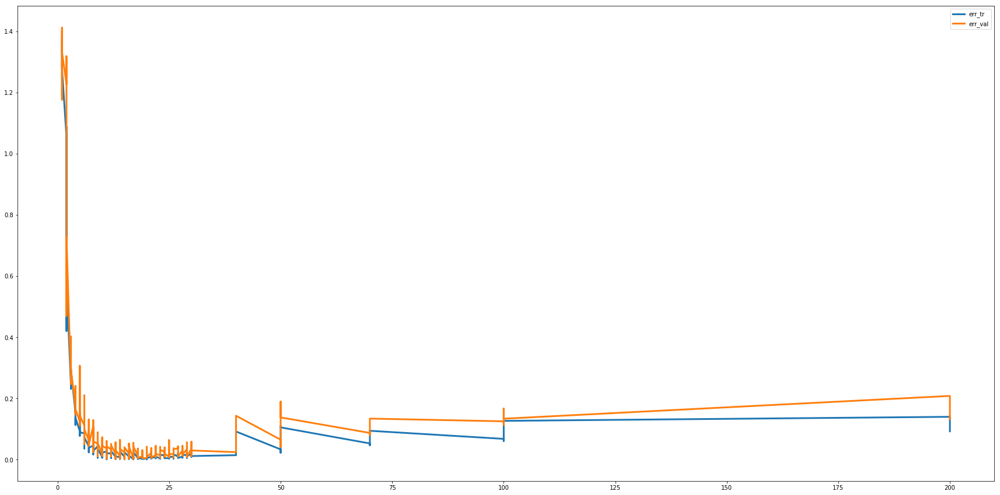

In [28]:
fig = plt.figure(figsize=(30,15))
plt.plot(res_df_all.neurons,res_df_all.err_tr,linewidth=3)
plt.plot(res_df_all.neurons,res_df_all.err_val,linewidth=3)
plt.legend()

C:\Users\dusic\Anaconda3\lib\site-packages\numpy\core\fromnumeric.py:61: FutureWarning: 
The current behaviour of 'Series.argmin' is deprecated, use 'idxmin'
instead.
The behavior of 'argmin' will be corrected to return the positional
minimum in the future. For now, use 'series.values.argmin' or
'np.argmin(np.array(values))' to get the position of the minimum
row.
  return bound(*args, **kwds)


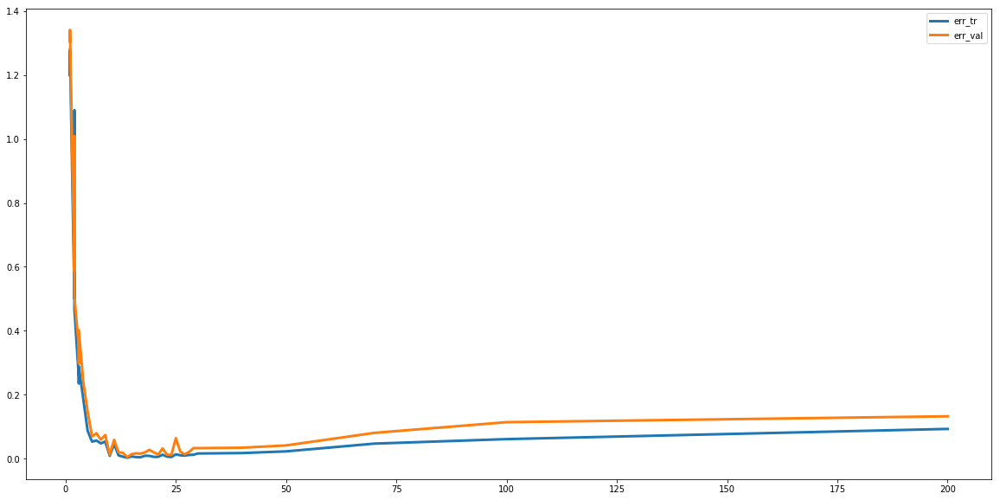

In [29]:
min_val_err=res_df_all.loc[np.argmin(res_df_all.err_val)]
rho_star=min_val_err['rho']
sigma_star=min_val_err['sigma']
reduced_res_df=res_df_all[(res_df_all.rho==rho_star)&(res_df_all.sigma==1)]

fig = plt.figure(figsize=(20,10))
plt.plot(reduced_res_df.neurons,reduced_res_df.err_tr,linewidth=3)
plt.plot(reduced_res_df.neurons,reduced_res_df.err_val,linewidth=3)
plt.legend()

In [30]:
#cm = sns.light_palette("green", as_cmap=True)
#reduced_res_df.style.background_gradient(cmap=cm, subset=['err_val'])

In [31]:
def highlight_min(s):
    '''
    highlight the minimum in a Series yellow.
    '''
    if type(s)==object:
        return
    is_min= s == s.min()
    return ['background-color: orchid' if v else '' for v in is_min]

### FINDING AN OPTIMAL configuration (the best approximation we found)

In [32]:
res_df_all=pd.read_csv('cv_results_MLP.csv')
reduced_res_df=res_df_all[(res_df_all.neurons<40) & (res_df_all.neurons>2)]
###reduced_res_df.set_index(['neurons','rho','sigma'],inplace=True)
#reduced_res_df.reset_index(drop=True).style.apply(highlight_min,axis=0)


neurons	rho	sigma
#0.00289611  ->16	0.0001	1

In [33]:
#reduced_res_df[reduced_res_df.sigma==1].style.apply(highlight_min,axis=0)



In [34]:
vals=res_df_all.loc[np.argmin(res_df_all.err_val)]
print(vals)
vals['rho']

err_tr           0.001381
err_val          0.002012
fun              0.003962
init_trr_err     1.671771
jac_norm         0.003829
neurons         15.000000
rho              0.000010
sigma            0.010000
Name: 235, dtype: float64


1e-05

In [35]:
df=res_df_all[res_df_all.sigma==1]
vals=df.loc[np.argmin(df.err_val)]
print(vals)
vals['rho']

err_tr           0.002243
err_val          0.002896
fun              0.004439
init_trr_err     1.642453
jac_norm         0.004540
neurons         16.000000
rho              0.000100
sigma            1.000000
Name: 258, dtype: float64


0.0001

In [36]:
rho=vals['rho']
sigma=vals['sigma']
N=int(vals['neurons'])
W,bias,V,omega=initializeParams(N)



mlp=MLP(rho,sigma,N)
cv_data=np.concatenate((data_train,data_validate))
X_train = np.transpose(np.matrix(cv_data)[:,0:2])
Y_train = np.transpose(np.matrix(cv_data)[:,2:])
res=minimize(mlp.reg_tr_error,omega.flatten(), args=[X_train,Y_train],method='L-BFGS-B')
omega_star=res['x']


Z = mlp.predict(omega_star,X_test)

#mlp.predict(omega_star,)

### Test error on the best configuration we found

In [37]:
cv_data=np.concatenate((data_train,data_validate))
#np.random.shuffle(cv_data)
err_test=calculate_test_err(cv_data,N,rho,sigma,omega_star)
print(err_test)

0.004356922352834327


In [38]:
def plotting(): 
 ##   rho=all_poss_conf[-2][1]
 ##   sigma=all_poss_conf[-2][2]
 ##   mlp=MLP(rho,sigma)
    
    fig = plt.figure(figsize=(70,40))
    ax = plt.axes(projection='3d')
   
  #  cv_data=np.concatenate((data_train,data_validate))
  #  X_train = np.transpose(np.matrix(cv_data)[:,0:2])
  #  Y_train = np.transpose(np.matrix(cv_data)[:,2:])
    
##    X_train = np.transpose(np.matrix(data)[:,0:2])
##    Y_train = np.transpose(np.matrix(data)[:,2:])
##
##    res=minimize(mlp.reg_tr_error,omega.flatten(), args=[X_train,Y_train],method='L-BFGS-B')
  #  for i in range(5):
  #      omega2=res['x']
  #      res=minimize(mlp.reg_tr_error,omega2.flatten(), args=[X_train,Y_train],method='L-BFGS-B')
            
    omega2=omega_star
    
#    xy = np.mgrid[2:-2.002:-0.05, 1:-1.002:-0.05].reshape(2,-1).T
    

##    xy = np.mgrid[1:-1:-0.05, -2:2.002:0.05].reshape(2,-1).T

    xy = np.mgrid[-2:2.002:0.02, 1:-1.002:-0.02].reshape(2,-1).T


#    xy = np.mgrid[-1:1:0.1, -2:2:0.1].reshape(2,-1).T
    X = xy[:, 0].squeeze()
    Y = xy[:, 1].squeeze()
    
    XY=np.concatenate((X,Y)).reshape(2,X.shape[0]).T

    
    Z = mlp.predict(omega_star,XY.T)
    Z = Z.T.reshape(X.shape[0],)

    ax = fig.gca(projection='3d')
   # ax.view_init(azim=-70)
    ax.set_xlim(-2,2)
    ax.set_ylim(1,-1)
    ax.set_zlim(-2,6)
    surf = ax.plot_trisurf(X, Y, Z, linewidth=0.010, antialiased=True,cmap='viridis')
    fig.savefig('11_MLP')
    plt.grid()
  #  return X.shape,Y.shape,Z.shape,X,Y,Z.T
 
    
   

    plt.show()

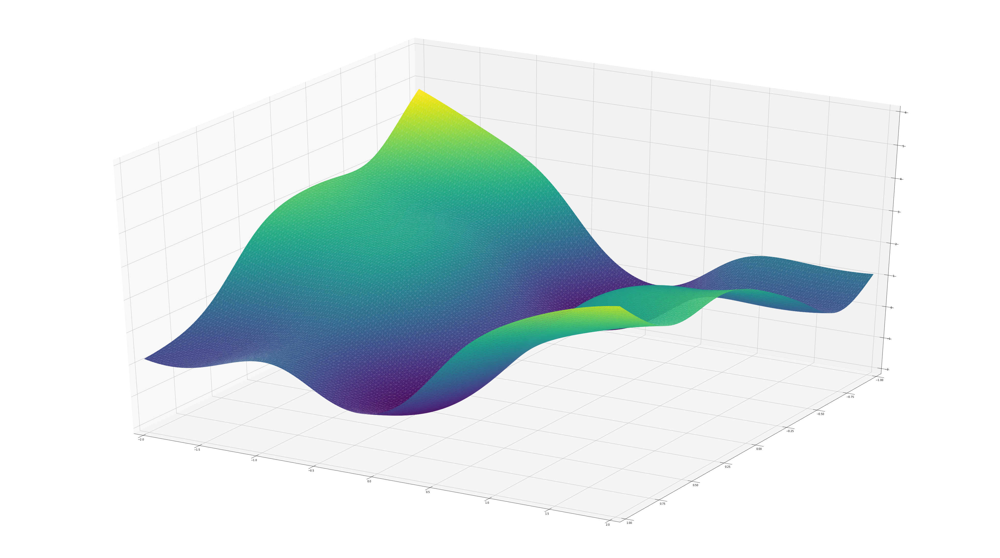

In [39]:
plotting()

In [40]:
## Flipping

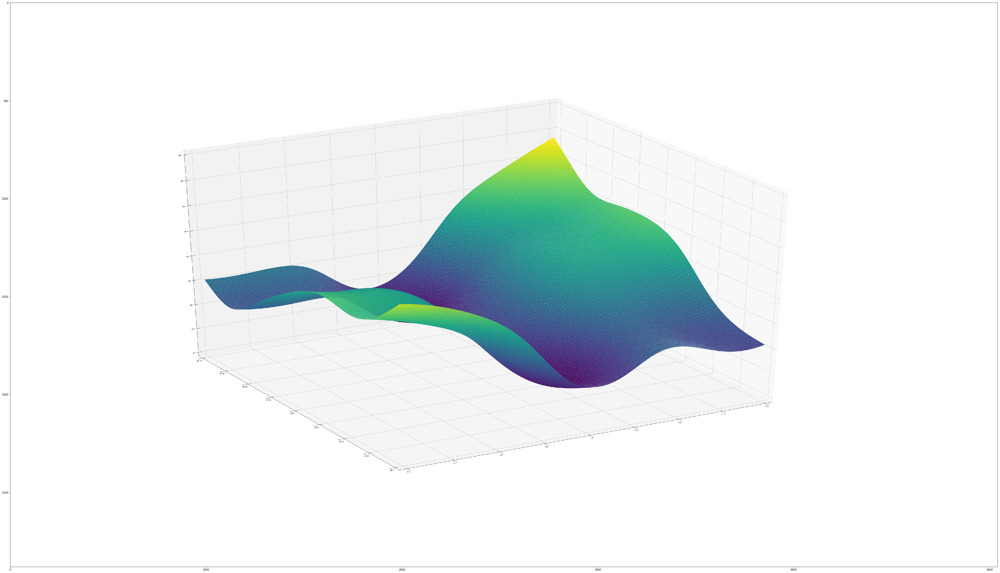

In [45]:
fig = plt.figure(figsize=(70,40))
im  = Image.open("11_MLP.png")
 
plt.imshow(np.fliplr(im))
plt.show()

# Q1  1.2

In [70]:
def initializeParams_q12(N):
    n=2
    n_y=1
    idxx = list(np.random.choice(X_train.shape[1], N))
    C = X_train[:,idxx].T##np.random.randn(N,n)#X_train[:,idxx].T#
    #print(C.shape)
    
    V = np.random.randn(N,n_y) 
    a=pd.DataFrame(V)
    a[2]=C[:,0]
    a[3]=C[:,1]
    #a[4]=bias
    omega=np.matrix(a)
    
 
   
    return C,V,omega

In [12]:
class RBF(object):
    
    def __init__(self, ro, sigma, N):
        self.ro = ro
        self.sigma = sigma 
        self.N = N

    def set_N(self, x): 
        self.N = x 
    def get_N(self): 
        return self.N     
    
    
    def second_norm(self,omega):
        return np.linalg.norm(omega)**2 

    
    def predict0(self,omega,X):  

        '''
        r=omega.flatten().shape[0]
        try:
            c=omega.flatten().shape[1]

            N=int(omega.shape[1]/4)

        except:
                N=int(omega.shape[0]/4)
                
        '''     
        N=self.N
        omega=omega.flatten().reshape((N,3))
        V = omega[:,0]
        C = omega[:,1:3]
        t1=np.apply_along_axis(np.linalg.norm, 1,X.T - C[0])#X.T - C1
        t = np.exp(-(t1/sigma**2)**2)
        S=t*V[0].item(0)
        for y in range(1,N):
            t1=np.apply_along_axis(np.linalg.norm, 1,X.T - C[y])#X.T - C1
            t = np.exp(-(t1/sigma**2)**2)
            S=S+t*V[y].item(0)
        
        #predicted_values=S
        return S#, W,bias
    def predict2(self,omega,X):  

        N=self.N
        sig = self.sigma
        omega=omega.flatten().reshape((N,3))
        V = omega[:,0]
        #X= X_train
        C1 = omega[:,1].T
        C2 = omega[:,2].T
        X1 = (X[0].T).reshape((X.shape[1],1))
        X2 = (X[1].T).reshape((X.shape[1],1))
        X1 = X1 - C1
        X2 = X2 - C2
        XX = -np.square(np.sqrt(np.square(X1)+np.square(X2))/sig)#(np.linalg.norm(X1,axis=1) + np.linalg.norm(X2,axis=1))
        XX= np.exp(XX)
        CX= XX.dot(V)
        CX= CX.reshape((X.shape[1],))
        
        return CX#, W,bias



    def reg_tr_error(self,omega,functionArgs):
        X=functionArgs[0]
        true=functionArgs[1]
        
        '''
        r=omega.flatten().shape[0]
        
        try:
            c=omega.flatten().shape[1]

            N=int(omega.shape[1]/4)

        except:
                N=int(omega.shape[0]/4)

        '''
        predicted=self.predict2(omega,X)


        err=np.array(predicted)-true #err_all=np.sum(np.array(predicted)-true)**2
        err_all=err.dot(err.T)


        P=X.shape[1]
        return ((err_all)/(2*P)+self.ro*self.second_norm(omega)).item(0)
    

  #  def get_params(self):
  #      return self.ro, self.sigma, self.N
    
  

In [539]:
A = np.matrix([[1, 1,1], [2, 2,2]])
B = np.matrix([[1,1],[1,1],[1,1],[1,1]])
#B = np.repeat(B, 2,axis=0)

#A = np.expand_dims(A, 2)
print(A)

[[1 1 1]
 [2 2 2]]


In [321]:
B.shape

(4, 2)

In [322]:
A.shape

(2, 3)

In [327]:
np.sqrt(np.square(A)+np.square(A))

matrix([[1.41421356, 1.41421356, 1.41421356],
        [2.82842712, 2.82842712, 2.82842712]])

In [226]:
X_train[1].shape


(1, 204)

In [582]:
ro=0.0001
sigma=1
N=2
C,V,omega=initializeParams_q12(N)

rbf=RBF(ro,sigma,N)
cv_data=np.concatenate((data_train,data_validate))
X_train = np.transpose(np.matrix(cv_data)[:,0:2])
Y_train = np.transpose(np.matrix(cv_data)[:,2:])
RR=rbf.predict0(omega.flatten(),X_train)
Rr1= rbf.predict2(omega.flatten(),X_train)
#print(RR)
#print(Rr1)
print(Y_train.shape)
print(mse(Y_train,Rr1))
print(mse(Y_train,RR))

st = time.time()
res=minimize(rbf.reg_tr_error,omega.flatten(), args=[X_train,Y_train],method='CG')
omega_star=res['x']
print(time.time()-st)
print(res['fun'])

(1, 255)
2.8097546422681887
2.8097546422681887
0.0386505126953125
0.1882090616108314


just checking

In [352]:
ro=0.00001
sigma=1.111
N=2
rbf=RBF(ro,sigma,N)
C,V,omega=initializeParams_q12(N)
rbf.predict2(omega.flatten(),X_validate).shape

(51, 1)

In [575]:
V = omega[:,0]
X= X_train
#X=np.expand_dims(X, axis=1)
C1 = omega[:,1].T
C2 = omega[:,2].T

X1 = (X[0].T).reshape((X.shape[1],1))
X2 = (X[1].T).reshape((X.shape[1],1))
X1 = X1 - C1
X2 = X2 - C2
XX = -np.square(np.sqrt(np.square(X1)+np.square(X2))/1.2)#(np.linalg.norm(X1,axis=1) + np.linalg.norm(X2,axis=1))
XX= np.exp(XX)#(np.linalg.norm(X1,axis=1) + np.linalg.norm(X2,axis=1))
CX= XX.dot(V)

In [576]:
omega=omega.flatten().reshape((N,3))
V = omega[:,0]
C = omega[:,1:3]
t1=np.apply_along_axis(np.linalg.norm, 1,X.T - C[0])#X.T - C1
t = np.exp(-(t1/1.2)**2)
S=t*V[0].item(0)
for y in range(1,N):
    t1=np.apply_along_axis(np.linalg.norm, 1,X.T - C[y])#X.T - C1
    t = np.exp(-(t1/1.2)**2)
    S=S+t*V[y].item(0)

In [570]:
S.shape

(255,)

In [571]:
CX.shape

(255, 1)

In [542]:
Y_train.shape


(1, 255)

In [577]:
mse(Y_train,CX.flatten())#rbf.predict2(omega_star.flatten(),Xtest))

2.999383628790304

In [578]:
mse(Y_train,S)#rbf.predict2(omega_star.flatten(),Xtest))

2.999383628790304

In [11]:
def fivefoldCV_q12(params):
    '''
    params a list N,rho,sigma
    '''
    global X_train, X_validate, X_test, Y_train, Y_validate, Y_test 

    K=3   # SO 4 folds for training 1-validation for testing; they switch every time
    cv_data=np.concatenate((data_train,data_validate))
    np.random.shuffle(cv_data)
    indices=np.arange(0,255,51)# [  0,  51, 102, 153, 204]
    folds=[]



  #  X=X_train

  #  true=Y_train

    N=params[0]
    rho=params[1]#10**-5 #10-5 unti, 10-3
    sigma=params[2]#1

    C,V,omega=initializeParams_q12(N)

    rbf=RBF(rho,sigma,N)


    P=cv_data.shape[0]

    rbf.set_N(N)
    
    #print(mlp.get_N())

    val_err_mse=[]
    train_err_mse=[]
    fun=[]
    jac_norm=[]
    init=[]

    #train_err={}
    #val_err={}

    data=cv_data.copy()


    res_df=pd.DataFrame(columns=['neurons','rho','sigma','fun','init','err_tr','jac_norm','err_val','err_test'])
    for i in range(len(indices)):
        cv_data=data
        if i<4:
            l=[i for i in range(indices[i],indices[i+1])]
            #(VALIDATION fold) for testing
            validate_cv=cv_data[indices[i]:indices[i+1],:]

            #train folds together for training
            df=pd.DataFrame(cv_data)
            train_cv=df.drop(df.index[l])



            X_train = np.transpose(np.matrix(train_cv)[:,0:2])
            Y_train = np.transpose(np.matrix(train_cv)[:,2:])
            X_validate = np.transpose(validate_cv[:,0:2])
            Y_validate = np.transpose(validate_cv[:,2:])
            init.append(mse(Y_train,rbf.predict2(omega.flatten(),X_train)))

            #print(omega.shape)
        #CHOSEN OMEGA? ->Fitting of the model
            res=minimize(rbf.reg_tr_error,omega.flatten(), args=[X_train,Y_train],method='CG')
     #       for i in range(10):
     #           omega=res['x']
     #           res=minimize(mlp.reg_tr_error,omega.flatten(), args=[X_train,Y_train],method='L-BFGS-B')
            
            omega=res['x']
            fun.append(res['fun'])
            jac_norm.append(second_norm_jac(res['jac'].T))

        #    err_tr=mse(reg_tr_error(omega.flatten(),[X_train,Y_train]))
            err_tr=mse(Y_train,rbf.predict2(omega.flatten(),X_train))
            err_val=mse(Y_validate,rbf.predict2(omega.flatten(),X_validate))

            train_err_mse.append(err_tr)
            val_err_mse.append(err_val)
            
             
           # train_err_dict[i]=
          #  val_err_dict[i]=mse(Y_validate,predict(omega.flatten(),X_validate))


        else:
            #for the last element
            l=list([i for i in range(indices[i],255)])
            #(VALIDATION fold) for testing
            validate_cv=cv_data[indices[i]:,:]

            #train folds together for training
            df=pd.DataFrame(cv_data)
            train_cv=df.drop(df.index[l])
            init.append(mse(Y_train,rbf.predict2(omega.flatten(),X_train)))

            #CHOSEN OMEGA? ->Fitting of the model
            res=minimize(rbf.reg_tr_error,omega.flatten(), args=[X_train,Y_train],method='CG')
          #  for i in range(10):
          #      omega=res['x']
          #      res=minimize(mlp.reg_tr_error,omega.flatten(), args=[X_train,Y_train],method='L-BFGS-B')
            
            omega=res['x']
            fun.append(res['fun'])
            jac_norm.append(second_norm_jac(res['jac'].T))


    
            err_tr=mse(Y_train,rbf.predict2(omega.flatten(),X_train))
       #     err_tr=mse(reg_tr_error(omega.flatten(),[X_train,Y_train]))
            err_val=mse(Y_validate,rbf.predict2(omega.flatten(),X_validate))

            train_err_mse.append(err_tr)
            val_err_mse.append(err_val)

      #      train_err_dict_mse[i]=mse(Y_train,predict(omega.flatten(),X_train))
       #     val_err_dict_mse[i]=mse(Y_validate,predict(omega,X_validate))

    err_test=calculate_test_err(cv_data,N,rho,sigma,omega)
    res_df=res_df.append({'neurons':N,'rho':rho,'sigma':sigma,'fun':np.mean(fun),'init':np.mean(init),\
                              'err_tr':np.mean(train_err_mse),'jac_norm':np.mean(jac_norm),\
                              'err_val':np.mean(val_err_mse),'err_test':err_test},ignore_index=True )
    return res_df

In [10]:
def second_norm_jac(omega): 
    return np.linalg.norm(omega)

def mse(true,predicted):
    return (np.sum(np.array(true-predicted)**2))/true.shape[1]


def calculate_test_err(cv_data,neurons,rho,sigma,omega):
    err=[]
    Rbf=RBF(rho,sigma,neurons)
    for i in range(1):
        X_train = np.transpose(np.matrix(cv_data)[:,0:2])
        Y_train = np.transpose(np.matrix(cv_data)[:,2:])
        #train on data train and data validate
        res=minimize(Rbf.reg_tr_error,omega.flatten(), args=[X_train,Y_train],method='CG')
        omega=res['x']
        #test on test data
        err.append(mse(Y_test,Rbf.predict2(omega.flatten(),X_test)))
    return np.mean(err)

In [21]:
neurons_count=[2,9,17,25,33]
rho_values=[0.001,0.0001,0.00001]
sigma_vals=[1.11,1.455,1.99]

all_poss_conf=[]
for i in neurons_count:
    for r in rho_values:
        for s in sigma_vals:
            all_poss_conf.append((i,r,s))

def get_data():
    data = df.to_numpy()
    data_train, data_rest = train_test_split(data, test_size=0.30)
    data_test, data_val = train_test_split(data_rest, test_size=0.50)
    data_train, data_validate, data_test = np.split(df.sample(frac=1), [int(.7*len(df)), int(.85*len(df))])
    data_train = data_train.to_numpy()
    data_validate = data_validate.to_numpy()
    data_test = data_test.to_numpy()

    X_tr = np.transpose(data_train[:,0:2])
    Y_tr = np.transpose(data_train[:,2:])
    X_val = np.transpose(data_validate[:,0:2])
    Y_val = np.transpose(data_validate[:,2:])
    X_test = np.transpose(data_test[:,0:2])
    Y_test = np.transpose(data_test[:,2:])
    return X_tr,Y_tr,X_val,Y_val,X_test,Y_test

X, y_true, Xval,Yval, Xtest, Ytest = get_data()
funn,starting_err,ending_err,jac_norm,val_err,test_err=[],[],[],[],[],[]
conf_q2=pd.DataFrame(columns=['neurons','rho','sigma','fun','start_err'\
                                            ,'ending_err','jac_norm',\
                                           'val_err','test_err'])
for conf in tqdm(all_poss_conf):
    C,V,omega=initializeParams_q12(conf[0])

    rbf=RBF(conf[1],conf[2],conf[0])
    res=minimize(rbf.reg_tr_error,omega.flatten(), args=[X,y_true],method='L-BFGS-B')
    omega_star=res['x']
    funn=res['fun']
    #pred_i = rbf.predict(omega.flatten(),X)
    starting_err=mse(y_true,rbf.predict2(omega.flatten(),X))
    ending_err=mse(y_true,rbf.predict2(omega_star.flatten(),X))
    jac_norm=second_norm_jac(res['jac'].T)
    val_err=mse(Yval,rbf.predict(omega_star.flatten(),Xval))
    X=np.concatenate((X.T,Xval.T)).T
    y_true=np.concatenate((y_true.T,Yval.T)).T
    res=minimize(rbf.reg_tr_error,omega_star.flatten(), args=[X,y_true],method='L-BFGS-B')
    omega_star=res['x']
    test_err=mse(Ytest,rbf.predict2(omega_star.flatten(),Xtest))
    conf_q2=conf_q2.append({'neurons':conf[0],'rho':conf[1],'sigma':conf[2],'fun':funn,'start_err':starting_err,\
                              'ending_err':funn,'jac_norm':jac_norm,\
                              'val_err':val_err,'test_err':test_err},ignore_index=True )


conf_q2

In [52]:
fivefoldCV_q12([3,0.0001,1])

,neurons,rho,sigma,fun,init,err_tr,jac_norm,err_val,err_test
0,3.0,0.0001,1.0,0.160633,1.024694,0.320648,0.000015,0.325887,0.394589


In [22]:
from tqdm.notebook import tqdm
res_df=pd.DataFrame()
for conf in tqdm(all_poss_conf):
    res_df=res_df.append(fivefoldCV_q12(conf))

KeyboardInterrupt: 

In [591]:
res_df.to_csv('q12_trial1.csv')

In [23]:
res_df

,neurons,rho,sigma,fun,init,err_tr,jac_norm,err_val,err_test
0,2.0,0.00100,1.110,0.192118,0.838658,0.325416,0.000006,0.356105,0.437585
0,2.0,0.00100,1.455,0.224351,0.680644,0.371357,0.000008,0.381180,0.434538
0,2.0,0.00100,1.990,0.297508,0.938049,0.473284,0.000009,0.532999,0.524789
0,2.0,0.00010,1.110,0.544401,1.491867,1.084179,0.000012,1.152039,0.429541
0,2.0,0.00010,1.455,0.186134,0.660541,0.363083,0.000010,0.376581,0.416403
0,2.0,0.00010,1.990,0.227482,1.013847,0.428444,0.000010,0.431340,0.455074
0,2.0,0.00001,1.110,0.800201,1.747101,1.599854,0.000012,1.591093,1.052608
0,2.0,0.00001,1.455,0.179826,0.710914,0.358684,0.000012,0.395827,0.415180
0,2.0,0.00001,1.990,0.212101,0.727774,0.420549,0.000010,0.444192,0.449641
0,9.0,0.00100,1.110,0.146215,1.116695,0.220572,0.000017,0.236758,0.294969


In [75]:
ro=0.00001
sigma=1.111
N=25
rbf=RBF(ro,sigma,N)
C,V,omega=initializeParams_q12(N)
#rbf.predict2(omega.flatten(),X_validate).shape
cv_data=np.concatenate((data_train,data_validate))
X_train = np.transpose(np.matrix(cv_data)[:,0:2])
Y_train = np.transpose(np.matrix(cv_data)[:,2:])
res=minimize(rbf.reg_tr_error,omega.flatten(), args=[X_train,Y_train],method='CG')
omega_star=res['x']
Z = rbf.predict2(omega_star,X_test)

In [76]:
print(mse(Y_test, Z))

0.02185945632443124


In [77]:
def plotting(): 
    fig = plt.figure(figsize=(70,40))
    ax = plt.axes(projection='3d')
   
    #omega2=omega_star
    
 #   xy = np.mgrid[-2:2.002:0.05, -1:1.002:0.05].reshape(2,-1).T
    xy = np.mgrid[-1:1.002:0.05, -2:2.002:0.05].reshape(2,-1).T

    X = xy[:, 0].squeeze()
    Y = xy[:, 1].squeeze()
    
    XY=np.concatenate((X,Y)).reshape(2,X.shape[0]).T

    Z = rbf.predict2(omega_star,XY.T)
    Z = Z.T.reshape(X.shape[0],)

    ax = fig.gca(projection='3d')
    ax.view_init(azim=30)
   # ax.set_zlim(-2,6)
    surf = ax.plot_trisurf(X, Y, Z, linewidth=0.010, antialiased=True,cmap='viridis')
    fig.savefig('11_MLP')
    plt.grid()
  #  return X.shape,Y.shape,Z.shape,X,Y,Z.T
 
    plt.show()

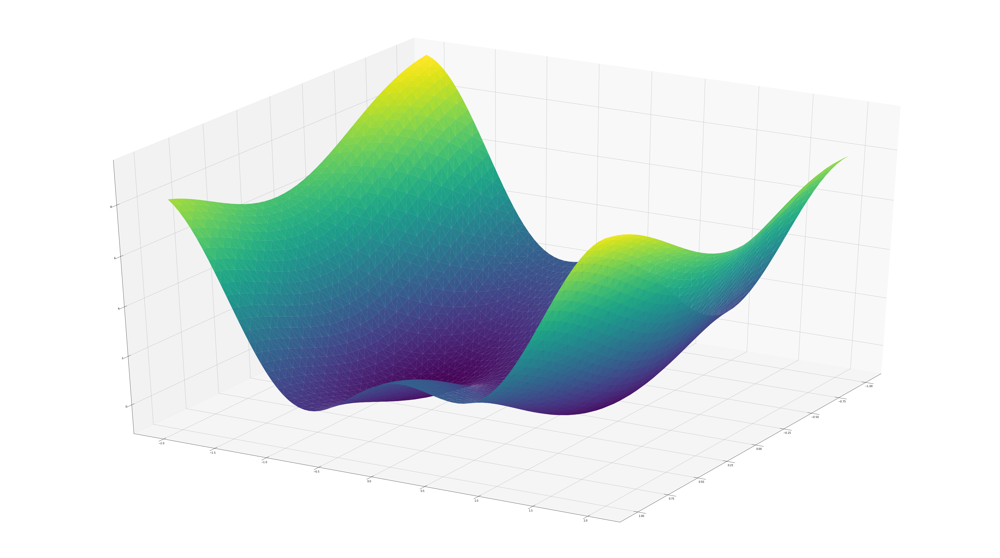

In [78]:
plotting()

neurons_count=[50,88,125]
rho_values=[0.001,0.0001,0.00001]
sigma_vals=[1.11,1.455,1.99]

all_poss_conf=[]
for i in neurons_count:
    for r in rho_values:
        for s in sigma_vals:
            all_poss_conf.append((i,r,s))

from tqdm.notebook import tqdm
res_df=pd.DataFrame()
for conf in tqdm(all_poss_conf):
    res_df=res_df.append(fivefoldCV_q12(conf))

res_df.to_csv('q12_trial1_bigvals.csv')

# Q2 Extreme Learning 2.1

In [18]:
class MLP_Q2(object):
    
    def __init__(self, ro, sigma, N):
        self.ro = ro
        self.sigma = sigma 
        self.N = N

    def set_N(self, x): 
        self.N = x 
    def get_N(self): 
        return self.N     
    
    
    def second_norm(self,omega):
        return np.linalg.norm(omega)**2 

    def activation_f(self,t,sigma=1):
        return (np.exp(2*sigma*t)-1)/(np.exp(2*sigma*t)+1)

    def predict(self,X, W, bias, V):  
  
        N=self.N
        t=W.dot(X)-bias
        #print(t.shape)
        predicted_values=V.dot(self.activation_f(t,sigma))
        return predicted_values#, W,bias




    def reg_tr_error(self,V,functionArgs):
        X=functionArgs[0]
        true=functionArgs[1]
        W = functionArgs[2]
        bias = functionArgs[3]
        
        predicted=self.predict(X,W,bias,V)


        err=np.array(predicted)-true #err_all=np.sum(np.array(predicted)-true)**2
        err_all=err.dot(err.T)


        P=X.shape[1]
        #omega_upd=np.append(np.append(V,W, axis=1), bias, axis=1)
        a=pd.DataFrame(V.T)
        a[2]=W[:,0]
        a[3]=W[:,1]
        a[4]=bias
        omega_upd=np.matrix(a)
        return ((err_all)/(2*P)+self.ro*self.second_norm(omega_upd)).item(0)
    

  #  def get_params(self):
  #      return self.ro, self.sigma, self.N
    
  

In [8]:
def initializeParams_q2(N):
    n=2
    n_y=1
    W = np.random.randn(N,n)*np.random.randn(N,n)*np.random.randn(N,n)
    bias = np.random.randn(N,1)*np.random.randn(N,1)*np.random.randn(N,1)
    V = np.random.randn(n_y,N) 
    a=pd.DataFrame(V.T)
    a[2]=W[:,0]
    a[3]=W[:,1]
    a[4]=bias
    omega=np.matrix(a)
    
 
   
    return W,bias,V,omega

In [22]:
from scipy import optimize
ro=0.00001#all_poss_conf[-2][1]
sigma=1#all_poss_conf[-2][2]
N=13#all_poss_conf[-2][0]
W,bias,V,omega=initializeParams_q2(N)

mlp_q2=MLP_Q2(ro,sigma,N)
cv_data=np.concatenate((data_train,data_validate))
X_train = np.transpose(np.matrix(cv_data)[:,0:2])
Y_train = np.transpose(np.matrix(cv_data)[:,2:])


In [17]:
res=minimize(mlp_q2.reg_tr_error,V, args=[X_train,Y_train, W, bias],method='CG')


In [18]:
V_star=res['x']

In [19]:
res

     fun: 0.7748942129855373
     jac: array([-1.50501728e-06, -4.11272049e-06])
 message: 'Optimization terminated successfully.'
    nfev: 60
     nit: 10
    njev: 15
  status: 0
 success: True
       x: array([-1.45387099,  0.39245743])

In [20]:
print(mlp_q2.reg_tr_error(V_star,[X_train,Y_train,W,bias]))

0.7748942129855373


In [21]:
print(mlp_q2.reg_tr_error(V_star,[X_test,Y_test,W,bias]))

0.42605318663561215


In [23]:
def q_2_mlp(rho,sigma,N,rep, X,Y,X_test,Y_test):
    test_err=[]
    train_err=[]
    from tqdm import tqdm
    for r in tqdm(range(rep)):
        W,bias,V,omega=initializeParams_q2(N)
        mlp=MLP_Q2(rho,sigma,N)
        res=minimize(mlp.reg_tr_error,V, args=[X,Y, W, bias],method='CG')
        V_star=res['x']
        curr_err=mlp.reg_tr_error(V_star,[X_test,Y_test,W,bias])
        test_err.append(curr_err)
        train_err.append(mlp.reg_tr_error(V_star,[X,Y,W,bias]))
        if np.min(test_err)==curr_err:
            best = (W,bias,V_star)
    return best,test_err,train_err

In [24]:
best_V_W_b,test_errs,train_errs=q_2_mlp(ro,sigma,N,10, X_train,Y_train,X_test,Y_test)

100%|██████████| 10/10 [05:02<00:00, 30.26s/it]


In [25]:
test_errs

[0.13010407241356184,
 0.19359023406108655,
 0.19135094237401568,
 0.18402610994800284,
 0.1107552328870741,
 0.21813944181318362,
 0.18617409752927047,
 0.14244003539662564,
 0.15662692396955538,
 0.1491054903857599]

In [26]:
train_errs

[0.1360953724723772,
 0.2908494108831902,
 0.2570995370222791,
 0.24653191945042321,
 0.09750420286043955,
 0.29905187581199494,
 0.21630391076363542,
 0.17630905221542847,
 0.1730937817076409,
 0.26229254368909266]

In [27]:
WW=best_V_W_b[0]
res_q2=pd.DataFrame(WW[:,0])
res_q2[2]=WW[:,1]
res_q2[3]=best_V_W_b[1]
res_q2[4]=best_V_W_b[2]
res_q2.to_csv('res_q2_W_b_V.csv')


In [28]:
res_q2=pd.read_csv('res_q2_W_b_V.csv',usecols=[1,2,3,4])
omega_upd=res_q2

In [29]:
omega_upd.values

array([[ 5.01350701e-02, -6.62105005e-02,  7.85067432e-03,
         9.00335585e-01],
       [-5.83327780e-01,  2.41402448e-01, -3.08233125e-01,
         1.14097479e+01],
       [-6.89766848e-02,  1.43182842e-01, -2.02375213e-01,
         1.94442997e+00],
       [-1.59130372e-01, -2.78933752e-01, -4.83339508e-01,
        -1.08144131e+01],
       [-4.21043593e-01, -3.91663544e-01,  9.86182272e-01,
         4.57470217e+00],
       [-2.28559877e-02, -1.07703120e-01,  2.65955865e-02,
         1.35231105e+00],
       [ 6.35284102e-01,  2.88880477e-01, -2.67361409e-01,
        -7.23669611e-01],
       [-8.88381600e-03,  1.75003438e-04, -1.37328693e+00,
         6.86069318e+00],
       [ 1.30802708e+00, -1.15776615e-01, -6.35138829e-01,
        -5.98744418e+00],
       [-1.28566583e-02, -1.00156343e+00, -6.56553309e-01,
         3.55810930e+00],
       [-6.91839738e-01,  9.47760887e-02, -5.68282569e-03,
        -1.68023643e+01],
       [ 1.49459141e-02,  2.66463882e-01,  7.60062298e-02,
      

In [30]:
best_V_W_b

(array([[ 5.01350701e-02, -6.62105005e-02],
        [-5.83327780e-01,  2.41402448e-01],
        [-6.89766848e-02,  1.43182842e-01],
        [-1.59130372e-01, -2.78933752e-01],
        [-4.21043593e-01, -3.91663544e-01],
        [-2.28559877e-02, -1.07703120e-01],
        [ 6.35284102e-01,  2.88880477e-01],
        [-8.88381600e-03,  1.75003438e-04],
        [ 1.30802708e+00, -1.15776615e-01],
        [-1.28566583e-02, -1.00156343e+00],
        [-6.91839738e-01,  9.47760887e-02],
        [ 1.49459141e-02,  2.66463882e-01],
        [-1.67312304e+00,  2.36174001e+00]]), array([[ 0.00785067],
        [-0.30823313],
        [-0.20237521],
        [-0.48333951],
        [ 0.98618227],
        [ 0.02659559],
        [-0.26736141],
        [-1.37328693],
        [-0.63513883],
        [-0.65655331],
        [-0.00568283],
        [ 0.07600623],
        [-0.55501829]]), array([  0.90033558,  11.40974794,   1.94442997, -10.81441305,
          4.57470217,   1.35231105,  -0.72366961,   6.86069318,

In [31]:
mlp_q2=MLP_Q2(ro,sigma,N)
print(mlp_q2.reg_tr_error(best_V_W_b[2],[X_test,Y_test,best_V_W_b[0],best_V_W_b[1]]))

0.1107552328870741


In [35]:
def plotting_q2(W_inp,bias_inp,V_inp): 
 ##   rho=all_poss_conf[-2][1]
 ##   sigma=all_poss_conf[-2][2]
 ##   mlp=MLP(rho,sigma)
    
    fig = plt.figure(figsize=(70,40))
    ax = plt.axes(projection='3d')
   
    a=pd.DataFrame(V_inp.T)
    a[2]=W_inp[:,0]
    a[3]=W_inp[:,1]
    a[4]=bias_inp
    omega2=np.matrix(a)
    
 #   xy = np.mgrid[-2:2.002:0.05, -1:1.002:0.05].reshape(2,-1).T
    xy = np.mgrid[-1:1.002:0.05, -2:2.002:0.05].reshape(2,-1).T

    X = xy[:, 0].squeeze()
    Y = xy[:, 1].squeeze()
    
    XY=np.concatenate((X,Y)).reshape(2,X.shape[0]).T
    #print(XY)

    
    Z = mlp_q2.predict(XY.T,W_inp,bias_inp,V_inp)
    Z = Z.T.reshape(X.shape[0],)

    ax = fig.gca(projection='3d')
    ax.view_init(azim=30)
   # ax.set_zlim(-2,6)
    surf = ax.plot_trisurf(X, Y, Z, linewidth=0.010, antialiased=True,cmap='viridis')
    fig.savefig('11_MLP')
    plt.grid()
  #  return X.shape,Y.shape,Z.shape,X,Y,Z.T
 
    
   

    plt.show()

In [36]:
uu=omega_upd.values[:,0:2]
bb=omega_upd.values[:,2].reshape(N,1)
vv=omega_upd.values[:,3].reshape(N,1).T
mlp_q2=MLP_Q2(ro,sigma,N)
print(mlp_q2.reg_tr_error(vv,[X_test,Y_test,np.array(uu),bb]))

0.11075523288707403


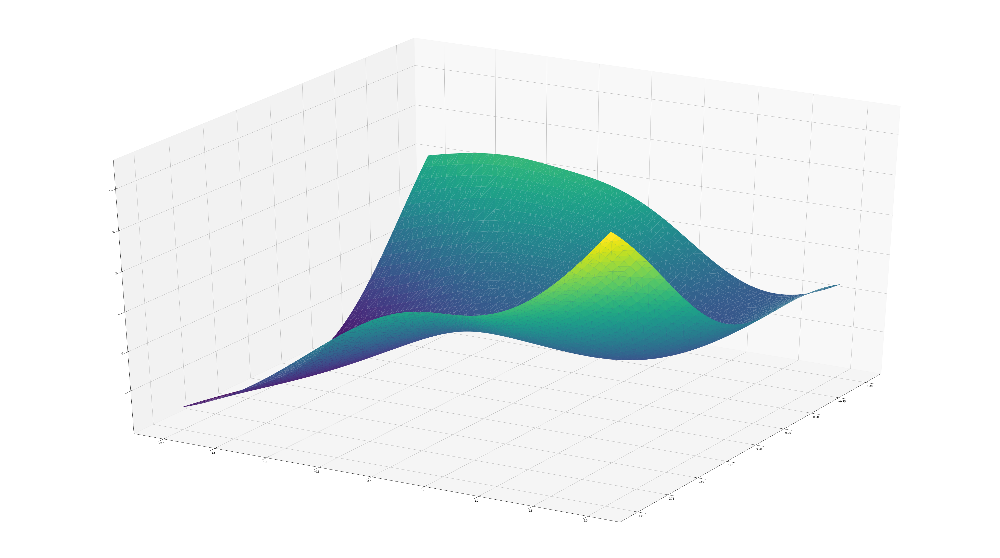

In [37]:
plotting_q2(np.array(uu),bb,vv)# with 13 neurons

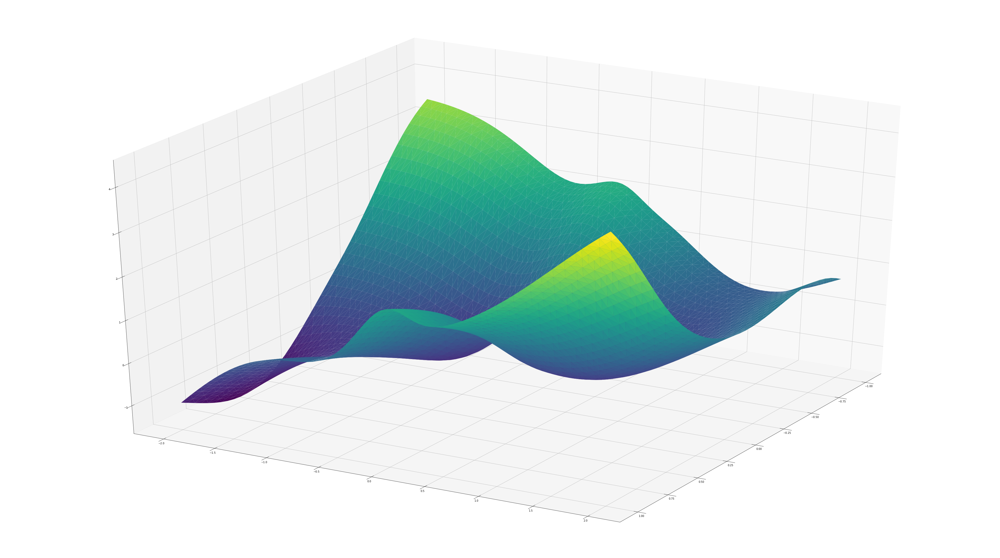

In [78]:
plotting_q2(np.array(uu),bb,vv)# with 25 neurons

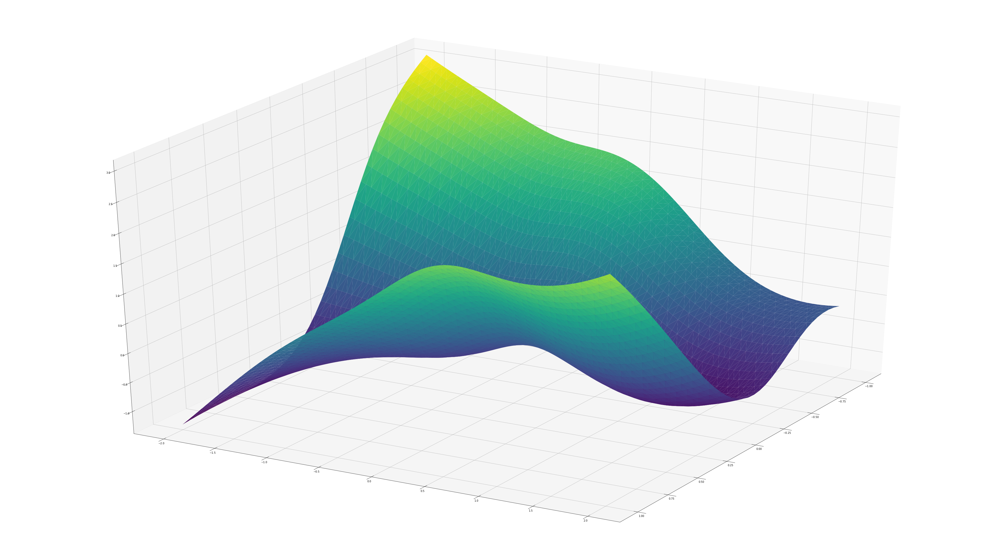

In [48]:
plotting_q2(np.array(uu),bb,vv)# with 20 neurons

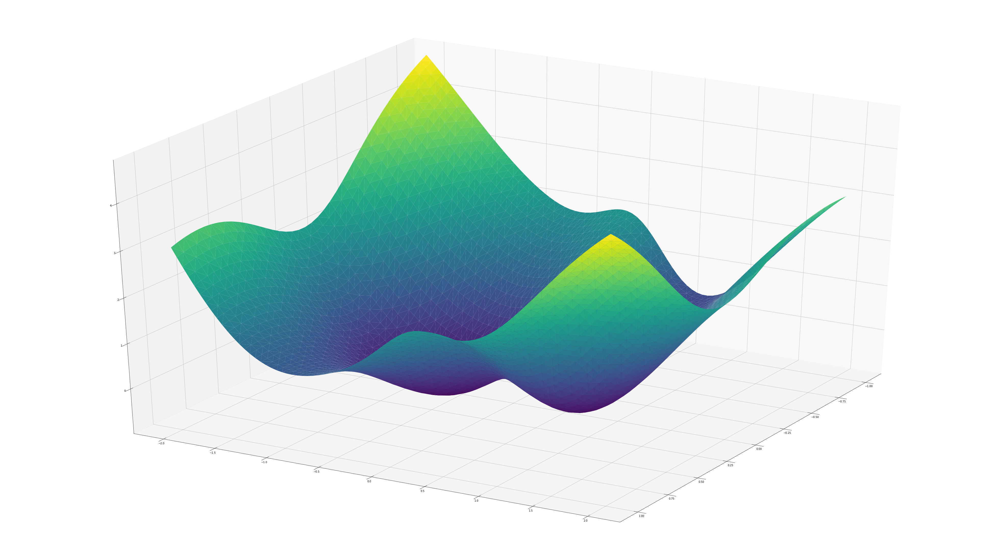

In [89]:
plotting_q2(np.array(uu),bb,vv)# with 33 neurons

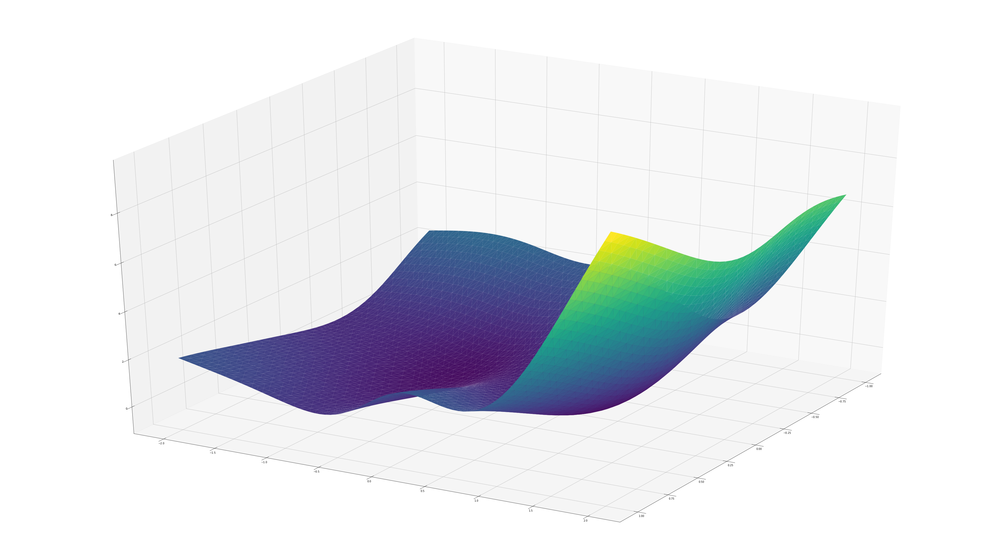

In [77]:
plotting_q2(np.array(uu),bb,vv)# with 23 neurons

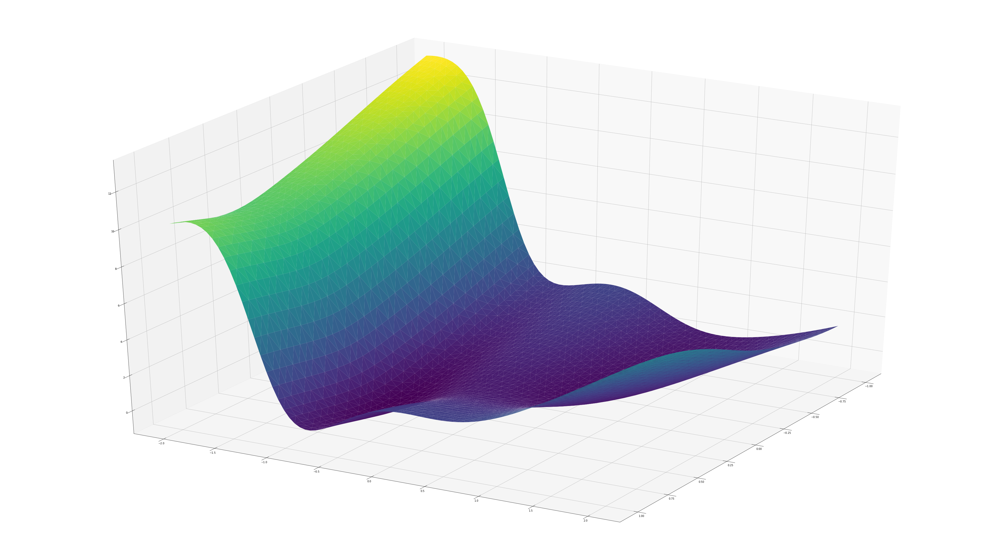

In [60]:
plotting_q2(best_V_W_b[0],best_V_W_b[1],best_V_W_b[2]) # with 17 neurons

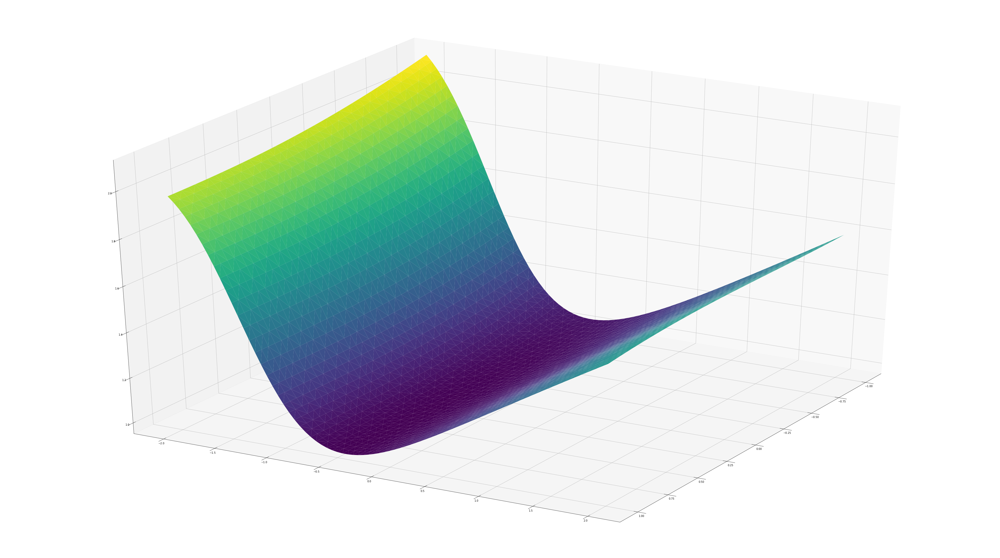

In [50]:
plotting_q2(best_V_W_b[0],best_V_W_b[1],best_V_W_b[2]) # with 3 neurons

# 2.2

In [22]:
from sklearn.cluster import KMeans

In [36]:
def initializeParams_q22(N, X):
    n=2
    n_y=1
    kmeans= KMeans(n_clusters=N, random_state=0).fit(X.T)
    #idxx = list(np.random.choice(X_train.shape[1], N))
    C = kmeans.cluster_centers_##X_train[:,idxx].T##np.random.randn(N,n)#X_train[:,idxx].T#
    #print(C.shape)
    
    V = np.random.randn(N,n_y) 
    a=pd.DataFrame(V)
    a[2]=C[:,0]
    a[3]=C[:,1]
    #a[4]=bias
    omega=np.matrix(a)
    
 
   
    return C,V,omega

In [41]:
class RBF_Q2(object):
    
    def __init__(self, ro, sigma, N):
        self.ro = ro
        self.sigma = sigma 
        self.N = N

    def set_N(self, x): 
        self.N = x 
    def get_N(self): 
        return self.N     
    
    
    def second_norm(self,omega):
        return np.linalg.norm(omega)**2 

    
    
    def predict2(self,V,C,X):  

        N=self.N
        sig = self.sigma
        #omega=omega.flatten().reshape((N,3))
        #V = omega[:,0]
        #X= X_train
        C1 = C[:,0].T
        C2 = C[:,1].T
        X1 = (X[0].T).reshape((X.shape[1],1))
        X2 = (X[1].T).reshape((X.shape[1],1))
        X1 = X1 - C1
        X2 = X2 - C2
        XX = -np.square(np.sqrt(np.square(X1)+np.square(X2))/sig)#(np.linalg.norm(X1,axis=1) + np.linalg.norm(X2,axis=1))
        XX= np.exp(XX)
        CX= XX.dot(V)
        CX= CX.reshape((X.shape[1],))
        
        return CX#, W,bias



    def reg_tr_error(self,V,functionArgs):
        X=functionArgs[0]
        true=functionArgs[1]
        C= functionArgs[2]
        
        predicted=self.predict2(V,C,X)


        err=np.array(predicted)-true #err_all=np.sum(np.array(predicted)-true)**2
        err_all=err.dot(err.T)


        P=X.shape[1]
        return ((err_all)/(2*P)+self.ro*self.second_norm(omega)).item(0)
    

  #  def get_params(self):
  #      return self.ro, self.sigma, self.N
    
  

In [50]:
#from scipy import optimize
ro=0.00001#all_poss_conf[-2][1]
sigma=1#all_poss_conf[-2][2]
N=25#all_poss_conf[-2][0]
C,V,omega=initializeParams_q22(N,X_train)

rbf_q2=RBF_Q2(ro,sigma,N)
cv_data=np.concatenate((data_train,data_validate))
X_train = np.transpose(np.matrix(cv_data)[:,0:2])
Y_train = np.transpose(np.matrix(cv_data)[:,2:])


In [51]:
res=minimize(rbf_q2.reg_tr_error,V, args=[X_train,Y_train, C],method='CG')

In [52]:
V_star=res['x']

In [53]:
res

     fun: 0.028675490843639788
     jac: array([ 1.71634369e-04,  3.89842317e-05,  2.03964766e-04,  6.38295896e-05,
        1.07442727e-04, -1.54622830e-06,  1.70086743e-04, -1.32655259e-05,
        1.08730281e-04,  3.54880467e-05,  8.94542318e-05,  1.08095119e-04,
        7.04417471e-05, -1.17694726e-04,  5.22395130e-05,  1.85360899e-04,
        1.48492400e-05,  3.40628903e-05,  5.91368880e-05,  1.28602143e-04,
        2.27988465e-04,  6.80154189e-05,  4.00214922e-05,  8.57929699e-05,
       -1.99414790e-05])
 message: 'Maximum number of iterations has been exceeded.'
    nfev: 256608
     nit: 5000
    njev: 9504
  status: 1
 success: False
       x: array([ 103.27639583,   45.22341032,   15.15937528,   12.8960106 ,
         27.16683414,    5.41877867,  -38.76792683,  -59.75290023,
       -123.49830973,   -4.58739809,    6.82880012,   13.79846758,
         31.34091131,    6.41063105,   34.16748049,    1.62677117,
         -2.94498219,  -74.38591433,  -15.9787272 ,  -57.04841735,
    

In [59]:
def q_2_rbf(rho,sigma,N,rep, X,Y,X_test,Y_test):
    test_err=[]
    train_err=[]
    from tqdm.notebook import tqdm
    for r in tqdm(range(rep)):
        C,V,omega=initializeParams_q22(N,X)
        rbf=RBF_Q2(rho,sigma,N)
        res=minimize(rbf.reg_tr_error,V, args=[X,Y, C],method='CG')
        V_star=res['x']
        curr_err=mse(Y_test,rbf.predict2(V_star,C,X_test))#rbf.reg_tr_error(V_star,[X_test,Y_test,C])
        test_err.append(curr_err)
        train_err.append(mse(Y,rbf.predict2(V_star,C,X)))
        if np.min(test_err)==curr_err:
            best = (C,V_star)
    return best,test_err,train_err

In [61]:
best_CV,test_errs,train_errs=q_2_rbf(ro,sigma,N,2, X_train,Y_train,X_test,Y_test)

In [65]:
def plotting_q22(C,V): 
 ##   rho=all_poss_conf[-2][1]
 ##   sigma=all_poss_conf[-2][2]
 ##   mlp=MLP(rho,sigma)
    
    fig = plt.figure(figsize=(70,40))
    ax = plt.axes(projection='3d')
  
    
 #   xy = np.mgrid[-2:2.002:0.05, -1:1.002:0.05].reshape(2,-1).T
    xy = np.mgrid[-1:1.002:0.05, -2:2.002:0.05].reshape(2,-1).T

    X = xy[:, 0].squeeze()
    Y = xy[:, 1].squeeze()
    
    XY=np.concatenate((X,Y)).reshape(2,X.shape[0]).T
    #print(XY)

    
    Z = rbf_q2.predict2(V,C,XY.T)
    Z = Z.T.reshape(X.shape[0],)

    ax = fig.gca(projection='3d')
    ax.view_init(azim=30)
   # ax.set_zlim(-2,6)
    surf = ax.plot_trisurf(X, Y, Z, linewidth=0.010, antialiased=True,cmap='viridis')
    fig.savefig('11_MLP')
    plt.grid()
  #  return X.shape,Y.shape,Z.shape,X,Y,Z.T
   
    plt.show()

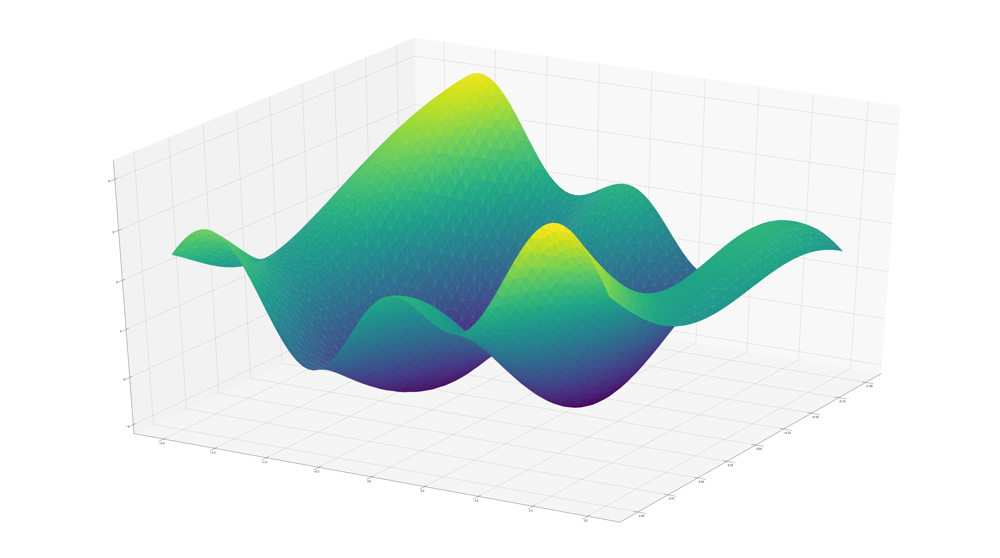

In [66]:
plotting_q22(best_CV[0],best_CV[1])

In [67]:
test_errs

[0.06609708556836404, 0.06621841050605265]

In [68]:
train_errs

[0.055561395587456396, 0.05539635645097757]